# Code for Oscilloscope Version 1

### Goal:
- read and plot single events of the oscilloscope from data_oscill
- Gaußfit for $\Delta t$ between events
- Categorizing single, double, triple photon signals to check statistics of manufacturer 

### Fixes:
1. add variable resolution to code 
2. Run5 has very little MCPPMT camera and HPD events 
3. add Gaußfits to the peaks

### Problems:
1. too few events of HPD and MCPPMT that are registered
    - maybe trigger on HPD instead of triggering on laser trigger $\rightarrow$ still keeps comparison of HPD and MCPPMT  (but no absolute quantum efficiency value)
2. 

In [298]:
import pandas as pd
import numpy as np
import scipy as sp
import pyarrow.parquet as pq
import time
import matplotlib.pyplot as plt
import argparse
import csv
import pyarrow as pa 

### general structure of data
- each wafeform (wfm) is initiated by the time stamp of the waveform (line with only one element)
- every following line (with three elements) has time-steps of 4e-011 (according to info file under resolution)


### approach
- probably not using pandas but simpler loop system
- loop on each line and see how many elements
- for each loop attach an x-coordinate while looping with used resolution

In [302]:
RESOLUTION = 4e-11
BUFFER_SIZE = 50_000  # number of rows to buffer before writing

def convert_csv_to_csv_and_parquet(in_path, out_csv_path, out_parquet_path):
    buffer = []
    event_id = -1
    t0 = None
    idx = 0

    parquet_writer = None

    with open(in_path) as fin, open(out_csv_path, "w") as fout:
        # write CSV header
        fout.write("event_id,timestamp,Ch_1,Ch_2,Ch_3\n")

        for line in fin:
            line = line.strip()
            if not line:
                continue

            parts = line.split(";")

            # new event
            if len(parts) == 1:
                event_id += 1
                t0 = float(parts[0])
                idx = 0
                continue

            # data row
            if len(parts) == 3:
                timestamp = t0 + idx * RESOLUTION
                idx += 1
                x, y, z = map(float, parts)

                # add to buffer
                buffer.append([event_id, timestamp, x, y, z])

                # flush buffer if full
                if len(buffer) >= BUFFER_SIZE:
                    # write CSV
                    for row in buffer:
                        fout.write(f"{row[0]},{row[1]},{row[2]},{row[3]},{row[4]}\n")

                    # write Parquet
                    df = pd.DataFrame(buffer, columns=["event_id", "timestamp", "Ch_1", "Ch_2", "Ch_3"])
                    table = pa.Table.from_pandas(df)
                    if parquet_writer is None:
                        parquet_writer = pq.ParquetWriter(out_parquet_path, table.schema, compression='snappy')
                    parquet_writer.write_table(table)

                    buffer = []

                continue

            raise ValueError(f"Unexpected format: {line}")

        # flush remaining buffer
        if buffer:
            for row in buffer:
                fout.write(f"{row[0]},{row[1]},{row[2]},{row[3]},{row[4]}\n")
            df = pd.DataFrame(buffer, columns=["event_id", "timestamp", "Ch_1", "Ch_2", "Ch_3"])
            table = pa.Table.from_pandas(df)
            if parquet_writer is None:
                parquet_writer = pq.ParquetWriter(out_parquet_path, table.schema, compression='snappy')
            parquet_writer.write_table(table)

        if parquet_writer:
            parquet_writer.close()


In [304]:
convert_csv_to_csv_and_parquet('/Users/laloscola/ExternalDrive/magic data laboratory/Wfm_triggered_on_HPD_Run1_2025-11-24_0_153434.Wfm.csv', '/Users/laloscola/ExternalDrive/magic data laboratory/cleaned_triggered_on_HPD_Run1.csv', '/Users/laloscola/ExternalDrive/magic data laboratory/cleaned_triggered_on_HPD_Run1.parquet')

### plotting
$\rightarrow$ let's now plot one event to see if it coincides with what we see on the oscilloscope

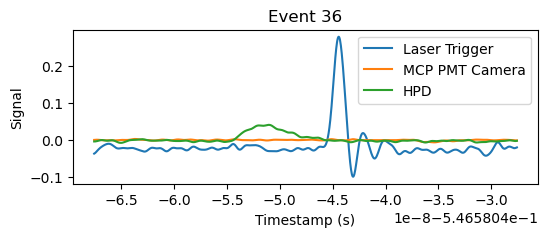

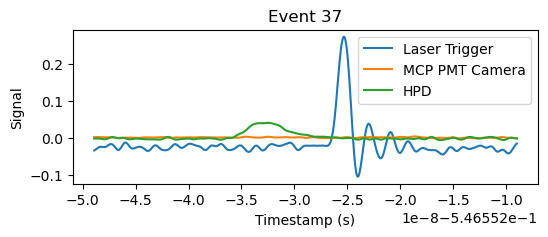

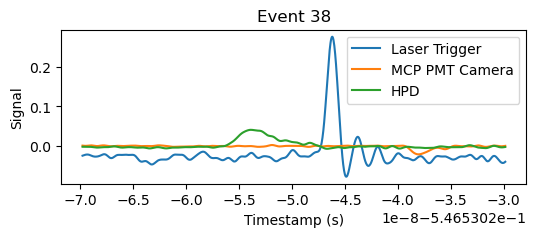

In [42]:
for i in range(36,37):
    plot_target_event('/Users/laloscola/ExternalDrive/magic data laboratory/cleaned_triggered_on_HPD_Run1.csv', target_event = i)

In [31]:
def plot_only_camera(cleaned_data, target_event = 0):
    df = pd.read_csv(cleaned_data)

    # filter for target event
    event= df[df['event_id'] == target_event] 

    # plot
    plt.figure(figsize=(6,2))
    plt.plot(event["timestamp"], event["Ch_2"], label="MCP PMT Camera")
    plt.xlabel("Timestamp (s)")
    plt.ylabel("Signal")
    plt.title(f"Event {target_event}")
    plt.legend()
    plt.show()

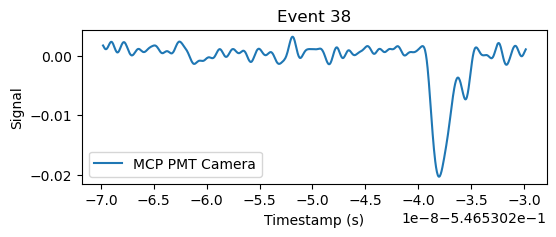

In [43]:
plot_only_camera('/Users/laloscola/ExternalDrive/magic data laboratory/cleaned_triggered_on_HPD_Run1.csv', target_event=38) # first interesting event for HPD triggering

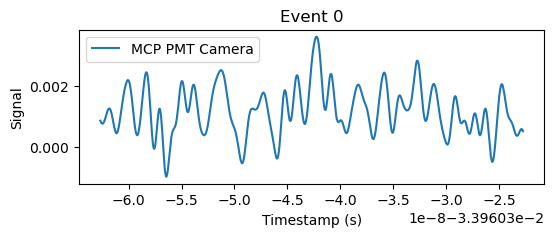

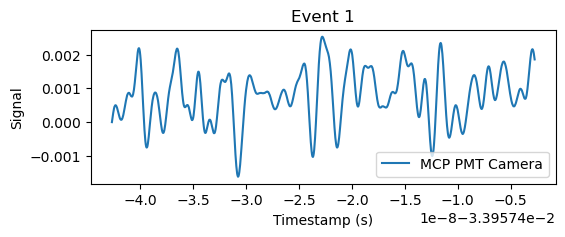

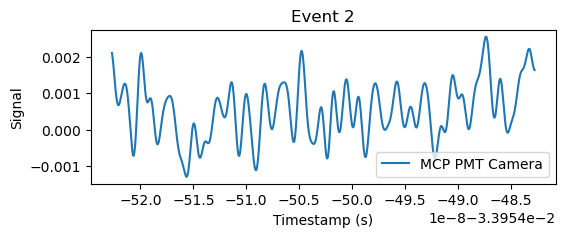

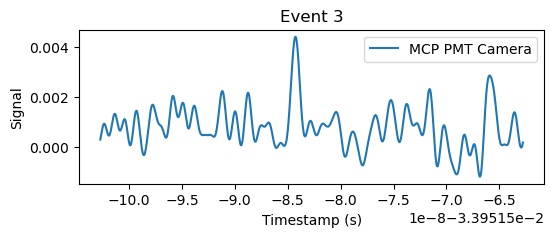

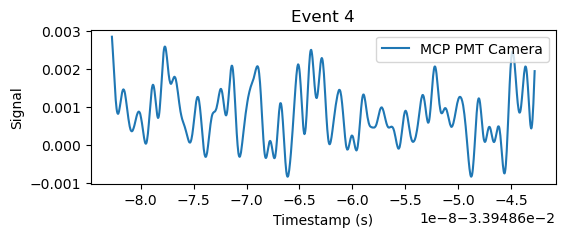

...

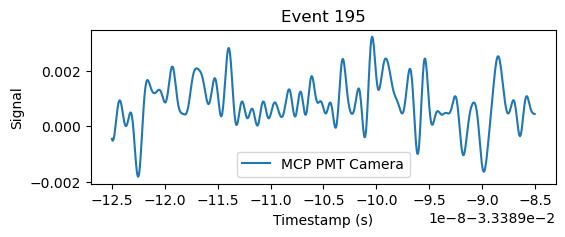

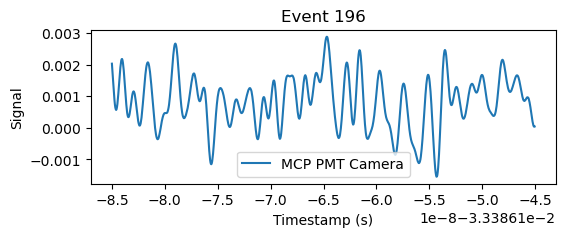

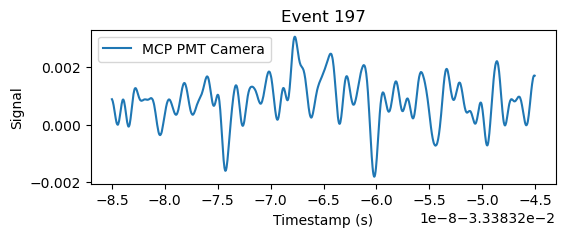

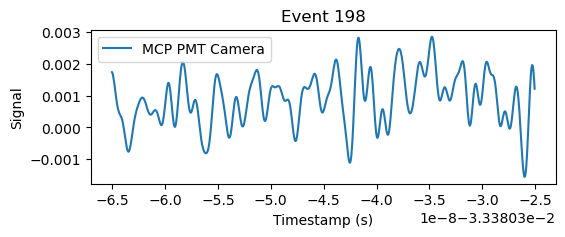

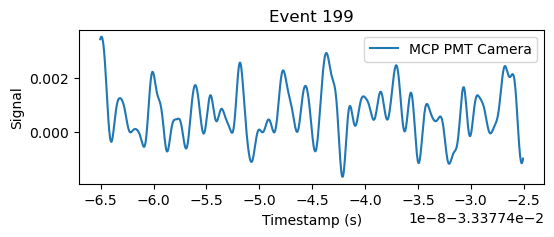

In [41]:
for i in range(0,200):
    plot_only_camera('/Users/laloscola/ExternalDrive/magic data laboratory/cleaned_triggered_on_LaserTrigger_Run2.csv', target_event=i)    
    # gives interesting events ~93,94,164 for Laser triggering

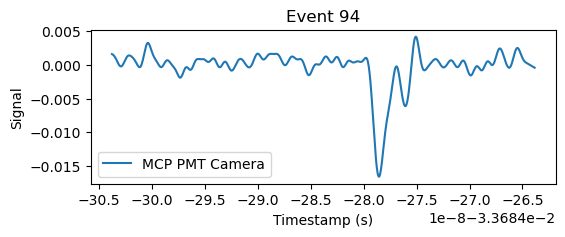

In [44]:
plot_only_camera('/Users/laloscola/ExternalDrive/magic data laboratory/cleaned_triggered_on_LaserTrigger_Run2.csv', target_event=94) # interesting events at ~94-95 for Laser triggering 

In [49]:
df = pd.read_csv('/Users/laloscola/ExternalDrive/magic data laboratory/cleaned_triggered_on_LaserTrigger_Run2.csv')

In [158]:
min_values = []
min_thresh = -0.01

In [95]:
for i in range(0,max(df['event_id'])):   # redefine as a function "minvalue_collector()" for clarity in code
    min_values.append(min(df['Ch_2'][df['event_id'] == i]))   # collecting minimal values of the Camera signal to construct a useful filter 
min_array = np.array(min_values)

In [160]:
count = np.sum(min_array < min_thresh) # rough estimate for statistics

In [162]:
interesting_ids = []
for i in range(0,max(df['event_id'])):
    if min(df['Ch_2'][df['event_id'] == i]) < min_thresh:    # collects the interesting event_id's in an array
        interesting_ids.append(i)         

In [163]:
print(interesting_ids)

[93, 94, 164, 239, 258, 306, 321, 369, 416, 448, 532, 670, 671, 729, 739, 805, 806, 829, 915, 941, 976, 1066, 1134, 1240, 1251, 1302, 1780, 1808, 1839, 1891, 1903, 2102, 2126, 2131, 2195, 2257, 2265, 2298, 2351, 2376, 2531, 2689, 2693, 2783, 2913, 2954, 3051, 3144, 3145, 3191, 3247, 3404, 3464, 3466, 3472, 3565, 3595, 3597, 3620, 3651, 3781, 3798, 3812, 3909, 3938, 4005, 4016, 4203, 4282, 4384, 4388, 4467, 4479, 4528, 4586, 4729, 4734, 4766, 4779, 5069, 5095, 5318, 5417, 5527, 5628, 5771, 5850, 5957, 5996, 6000, 6055, 6097, 6151, 6196, 6206, 6390, 6430, 6494, 6530, 6532, 6558, 6600, 6602, 6696, 6745, 6766, 6782, 6869, 6901, 6950, 6973, 7027, 7132, 7179, 7216, 7281, 7304, 7357, 7416, 7537, 7562, 7710, 7899, 7926, 7968, 7972, 8002, 8031, 8053, 8191, 8223, 8229, 8238, 8347, 8403, 8463, 8537, 8630, 8670, 8718, 8721, 8867, 8901, 9021, 9091, 9206, 9218, 9244, 9404, 9413, 9428, 9552, 9609, 9815]


In [168]:
print(count) # adapting the light such that the ratio of count/max(df['event_id']) ~1/10

154


### Goal 
1. make a counter that can estimate the ratio of empty events to non-empty events
2. based on this counter make a good filter
   - filtering for amplitude
   - filter on shape of the pulse -> fit every interesting pulse and if it deviates too much from the Gauß shape delete it

### Issue with counter code above
- too slow $\rightarrow$ make a counter that is based on pandas instead of simple loops


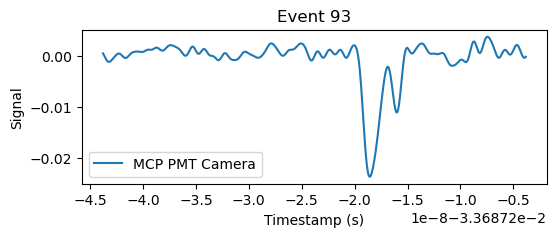

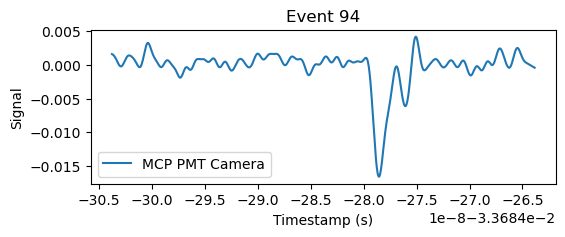

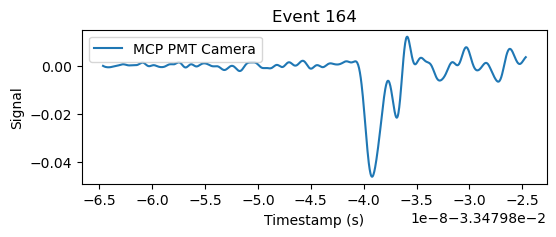

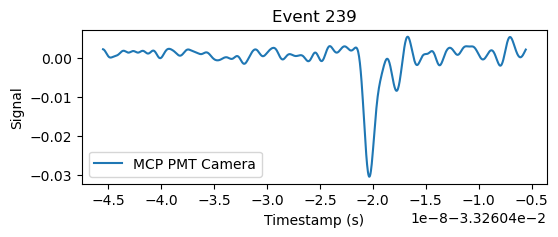

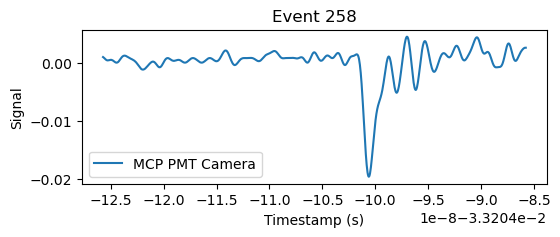

...

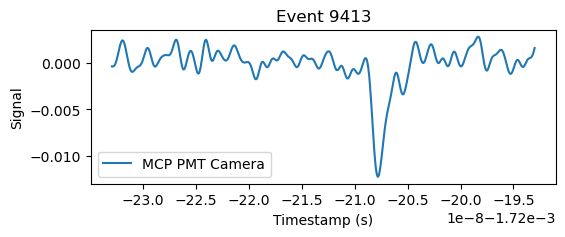

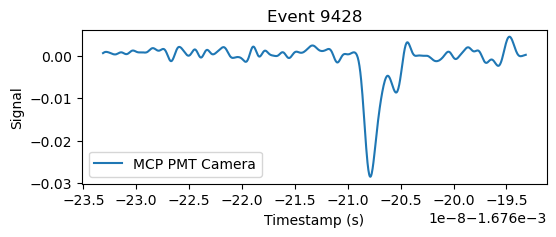

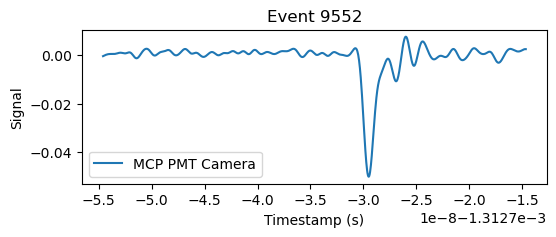

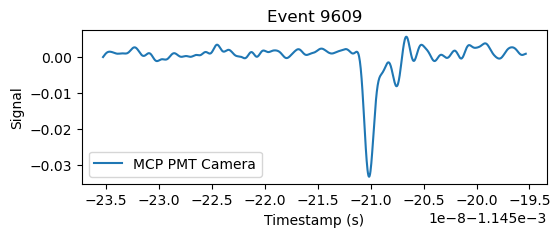

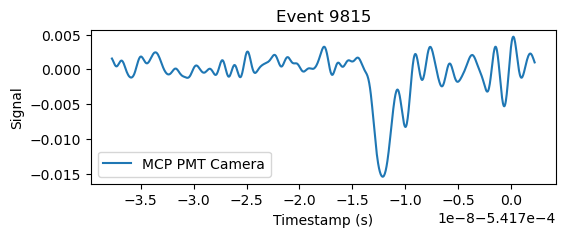

In [172]:
for j in interesting_ids: # viewing the interesting ids to gauge the threshold and visually check interesting events
    plot_only_camera('/Users/laloscola/ExternalDrive/magic data laboratory/cleaned_triggered_on_LaserTrigger_Run2.csv', target_event=j)

In [292]:
### one code 
def load_df(data): # load data no matter if already df or file
    # Case 1: filename 
    if isinstance(data, str):
        df = pd.read_csv(data)   
    
    # Case 2: already a DataFrame 
    elif isinstance(data, pd.DataFrame):
        df = data
    
    else:
        raise TypeError("Input must be a filename or a pandas DataFrame.")
    return df
    
def plot_all_channels(df, target_event = 0):
    # filter for target event
    event= df[df['event_id'] == target_event] 

    # plot
    plt.figure(figsize=(6,2))
    plt.plot(event["timestamp"], event["Ch_1"], label="Laser Trigger")
    plt.plot(event["timestamp"], event["Ch_2"], label="MCP PMT Camera")
    plt.plot(event["timestamp"], event["Ch_3"], label="HPD")
    plt.xlabel("Timestamp (s)")
    plt.ylabel("Signal")
    plt.title(f"Event {target_event}")
    plt.legend()
    plt.show()

def plot_only_camera(df, target_event = 0):
    # filter for target event
    event= df[df['event_id'] == target_event] 

    # plot
    plt.figure(figsize=(6,2))
    plt.plot(event["timestamp"], event["Ch_2"], label="MCP PMT Camera")
    plt.xlabel("Timestamp (s)")
    plt.ylabel("Signal")
    plt.title(f"Event {target_event}")
    plt.legend()
    plt.show()

def interesting_value_filter(df, min_thresh):
    # one grouped min over the whole DataFrame
    mins = df.groupby('event_id')['Ch_2'].min()
    # select only those event_ids whose min < threshold
    interesting_ids = mins[mins < min_thresh].index.to_list()
    return interesting_ids


def main(data, min_thresh = -0.01, show_plots=True):
    '''Usage:
        1. Input of the cleaned file after convert_csv_to_csv_and_parquet
        2. Define acceptable threshold for the minima one wants to accept
       Purpose:
        - takes an oscilloscope dataset and returns the ratio of 
    '''
    df = load_df(data)  # returns df if either pandas dataframe or directly from file
    interesting_ids = interesting_value_filter(df, min_thresh)
    
    ratio = len(interesting_ids)/(max(df['event_id'])+1)
    percentage = ratio * 100
    print(f'There are: {len(interesting_ids)} interesting events, that match the used threshold')
    # print(f'These events are numbered: {interesting_ids}')
    print(f'The percentage of interesting events to empty events is: {percentage:.5f}%')

    if show_plots:
        for i in interesting_ids:
            plot_all_channels(df, target_event=i)
            plot_only_camera(df, target_event=i)
    

    

There are: 154 interesting events, that match the used threshold
The percentage of interesting events to empty events is: 1.53985%


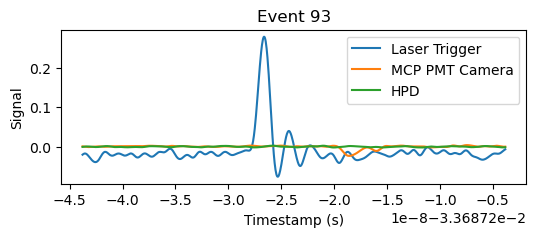

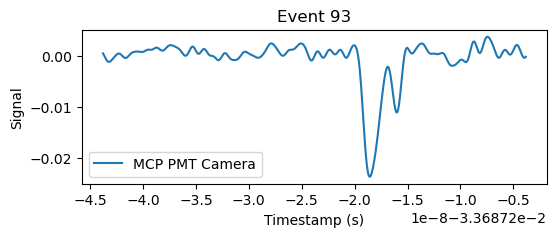

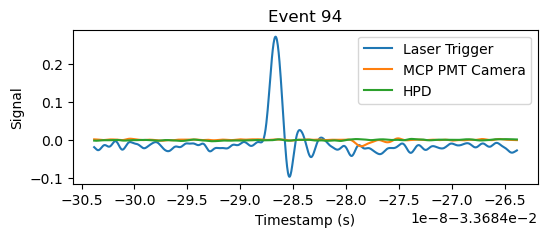

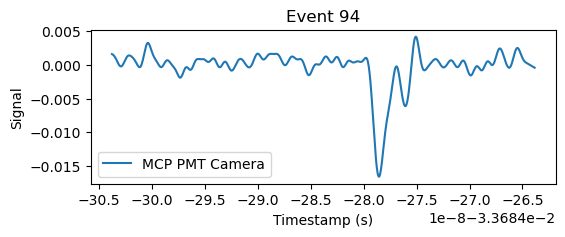

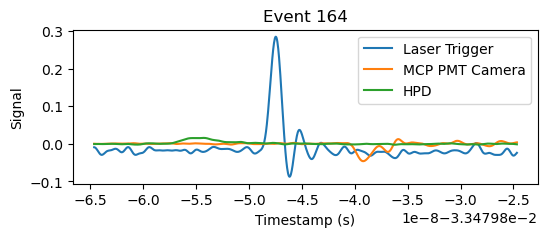

...

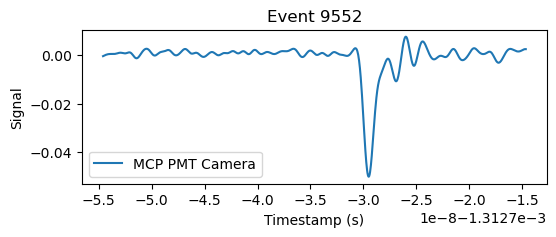

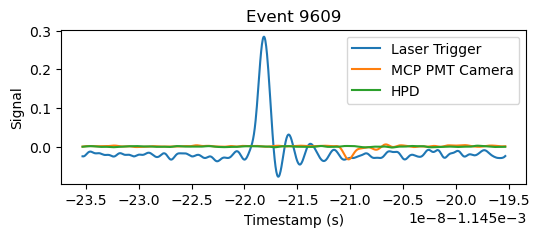

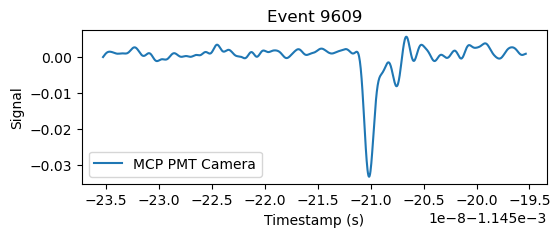

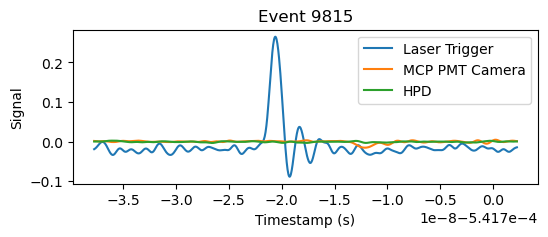

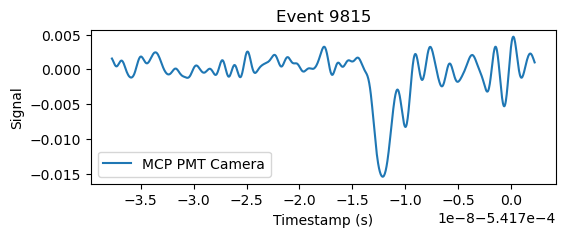

In [288]:
main('/Users/laloscola/ExternalDrive/magic data laboratory/cleaned_triggered_on_LaserTrigger_Run2.csv')

There are: 12 interesting events, that match the used threshold
The percentage of interesting events to empty events is: 1.67131%


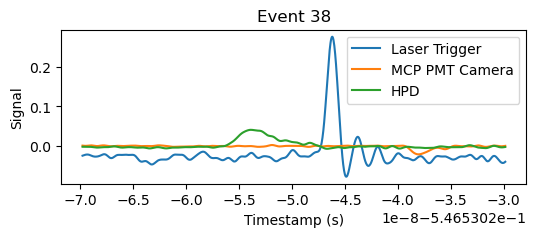

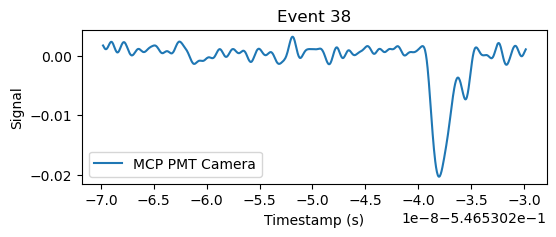

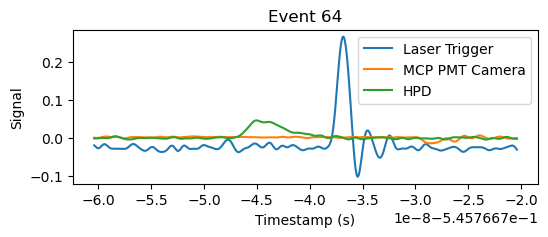

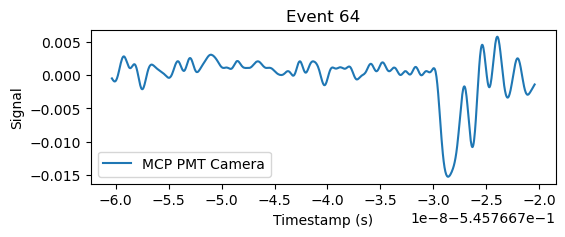

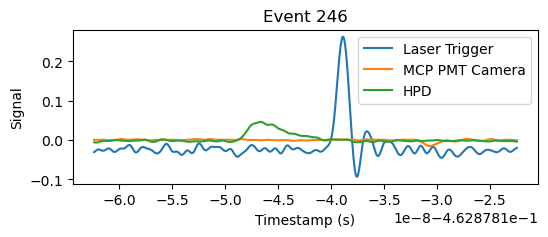

...

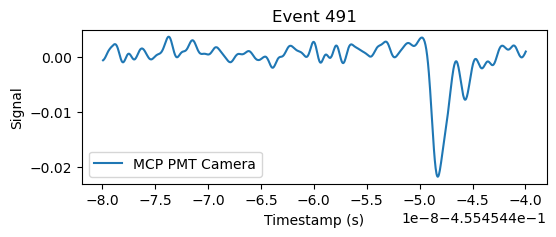

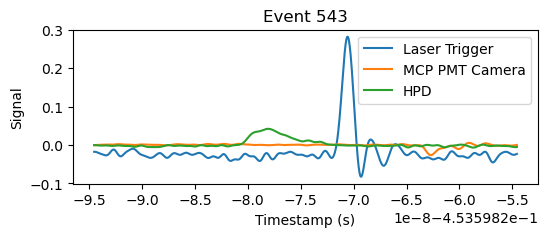

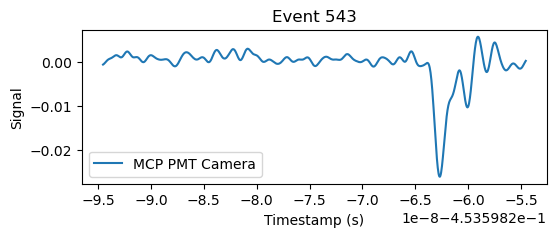

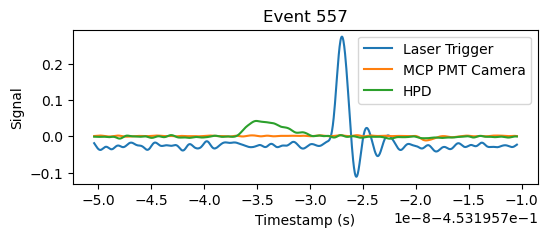

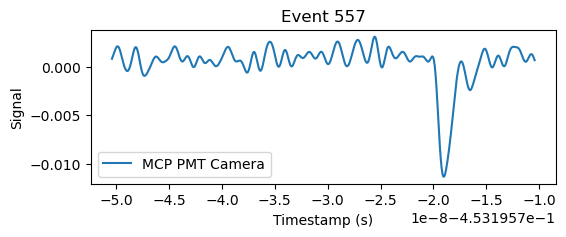

In [289]:
main('/Users/laloscola/ExternalDrive/magic data laboratory/cleaned_triggered_on_HPD_Run1.csv')

### Gauss comparator filters
1. accept only minima in a certain position 
2. afterwards Gauss fit and check for deviation

In [294]:
df_HPD = load_df('/Users/laloscola/ExternalDrive/magic data laboratory/cleaned_triggered_on_HPD_Run1.csv')

In [296]:
print(df_HPD['event_id'].max())

717
